In [1]:
import scanpy as sc
import squidpy as sq

import numpy as np
import pandas as pd

In [2]:
adata = sc.read_h5ad('datasets/cosmx_melanoma/Melanoma_5612.h5ad')
adata

AnnData object with n_obs × n_vars = 56761 × 960
    obs: 'fov', 'CPID', 'cell_ID', 'SPID', 'Core Type', 'Control Surgical Number', 'block', 'SEX', 'RACE', 'AGE_AT_DX', 'DX_STAGE', 'BEST_RESPONSE_BY_SCAN', 'PFS_BY_SCAN', 'PROG_STATUS_BY_SCAN', 'OS_FROM_START_OF_ITX', 'VITAL', 'SPEC_CATEGORY', 'Prior_Checkpoint_Blockade', 'TREATMENT', 'MUTATION', 'cellID_str', 'celltype', 'niche', 'CPID_str'
    var: 'mean', 'std'
    uns: 'CPID_str_colors', 'celltype_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [3]:
from simvi.model import SimVI
SimVI.setup_anndata(adata)
edge_index = SimVI.extract_edge_index(adata,batch_key='CPID_str',n_neighbors=10)

from pytorch_lightning.utilities.seed import seed_everything
seed_everything(0)
model = SimVI(adata,kl_weight=1,kl_gatweight=0.01,lam_mi=1000,permutation_rate=0.5,n_spatial=20,n_intrinsic=20)
train_loss, val_loss = model.train(edge_index,max_epochs=100,batch_size=5000,use_gpu=True,mae_epochs=75,device='cuda:2')
adata.obsm['simvi_z'] = model.get_latent_representation(edge_index,representation_kind='intrinsic',give_mean=True)
adata.obsm['simvi_s'] = model.get_latent_representation(edge_index,representation_kind='interaction',give_mean=True)
adata.obsm['simvi'] = np.hstack((adata.obsm['simvi_z'],adata.obsm['simvi_s']))

Global seed set to 0
No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
Global seed set to 0
Epoch 100/100: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [15:05<00:00,  9.06s/it, train_loss=480, val_loss=484.39197]


In [8]:
np.save('Bio_results/cosmx/simvi_z_final.npy',adata.obsm['simvi_z'])
np.save('Bio_results/cosmx/simvi_s_final.npy',adata.obsm['simvi_s'])

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


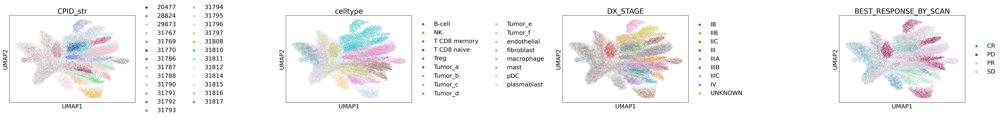

In [41]:
sc.pp.neighbors(adata,use_rep='simvi_z')
sc.tl.umap(adata)


import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
plt.rcParams["font.size"] = 18



adata.uns['BEST_RESPONSE_BY_SCAN_colors'] = ['#2c7fb8','#980043','#a1dab4','#d7b5d8']
sc.pl.umap(adata,color=['CPID_str','celltype','DX_STAGE','BEST_RESPONSE_BY_SCAN'],wspace=1,save='cosmxfull_z.pdf')

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


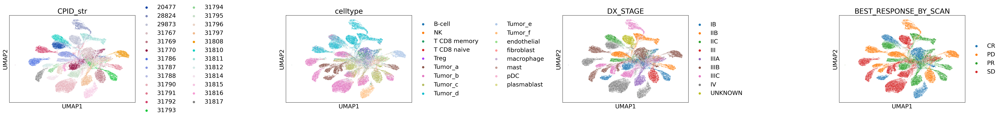

In [5]:
sc.pp.neighbors(adata,use_rep='simvi_s')
sc.tl.umap(adata)

import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
plt.rcParams["font.size"] = 18
sc.pl.umap(adata,color=['CPID_str','celltype','DX_STAGE','BEST_RESPONSE_BY_SCAN'],wspace=1)

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


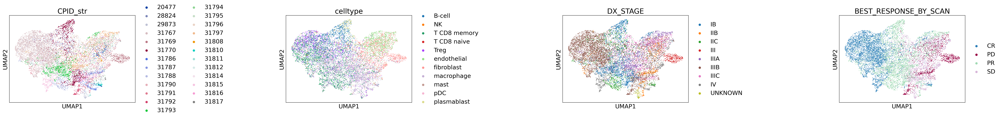

In [36]:
adata_immune = adata[~adata.obs['celltype'].str.contains('Tumor')].copy()
sc.pp.neighbors(adata_immune,use_rep='simvi_s')
sc.tl.umap(adata_immune)

adata_immune.uns['BEST_RESPONSE_BY_SCAN_colors'] = ['#2c7fb8','#980043','#a1dab4','#d7b5d8']

plt.rcParams["font.size"] = 18

sc.pl.umap(adata_immune,color=['CPID_str','celltype','DX_STAGE','BEST_RESPONSE_BY_SCAN'],wspace=1,save='notumor_s.pdf')

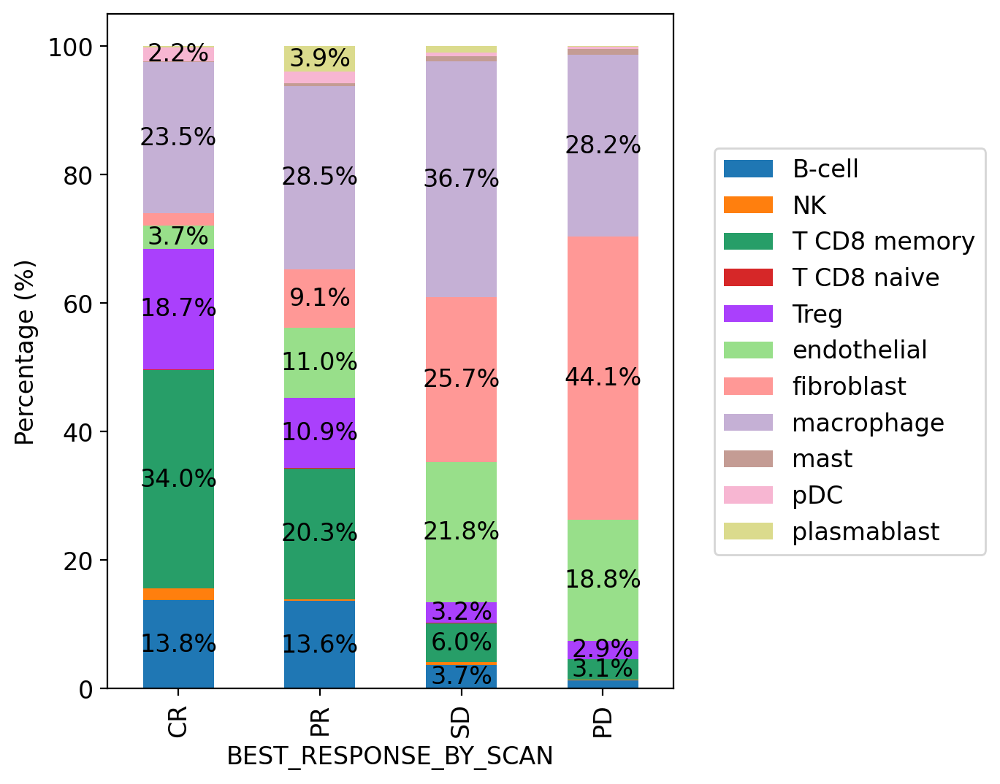

In [42]:
df = pd.DataFrame(adata_immune.obs[['celltype','BEST_RESPONSE_BY_SCAN']].copy())

plt.rcParams["font.size"] = 12

count_df = df.groupby(['BEST_RESPONSE_BY_SCAN','celltype']).size().unstack(fill_value=0)

#count_df = count_df.loc[count_df.values.sum(axis=1)>10]
count_df = count_df.div(count_df.sum(axis=1),axis=0) * 100

#count_df = count_df.reindex(["No stimulation", "IFN-III","IFNa2","IL-6","TNFa","IFNg","IFNb","IFNb+IL-6","IFNb + TNFa","IFNb+ IFNg"])
ax = count_df.iloc[[0,2,3,1]].plot(kind='bar', stacked=True,figsize=(5,6),color=['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#98df8a',
       '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'])


threshold = 2.0

for bars in ax.containers:
    percentages = [(bar.get_height() ) for bar in bars]

    labels = [f'{percent:.1f}%' if percent > threshold else '' for percent in percentages]
    
    ax.bar_label(bars, labels=labels, label_type='center')

#plt.xlabel('Category in col1')
plt.ylabel('Percentage (%)')
#plt.title('Stacked Bar Plot by col2 Categories in Each col1 Category')

plt.legend(loc="center left", bbox_to_anchor=(1.05, 0.5))

plt.savefig('figures/cosmx_ct_composition.pdf',bbox_inches='tight')

plt.show()

/tmp/ipykernel_3902406/2980690904.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['celltype_notumor'][adata.obs['celltype'].str.contains('Tumor')] = 'Tumor'


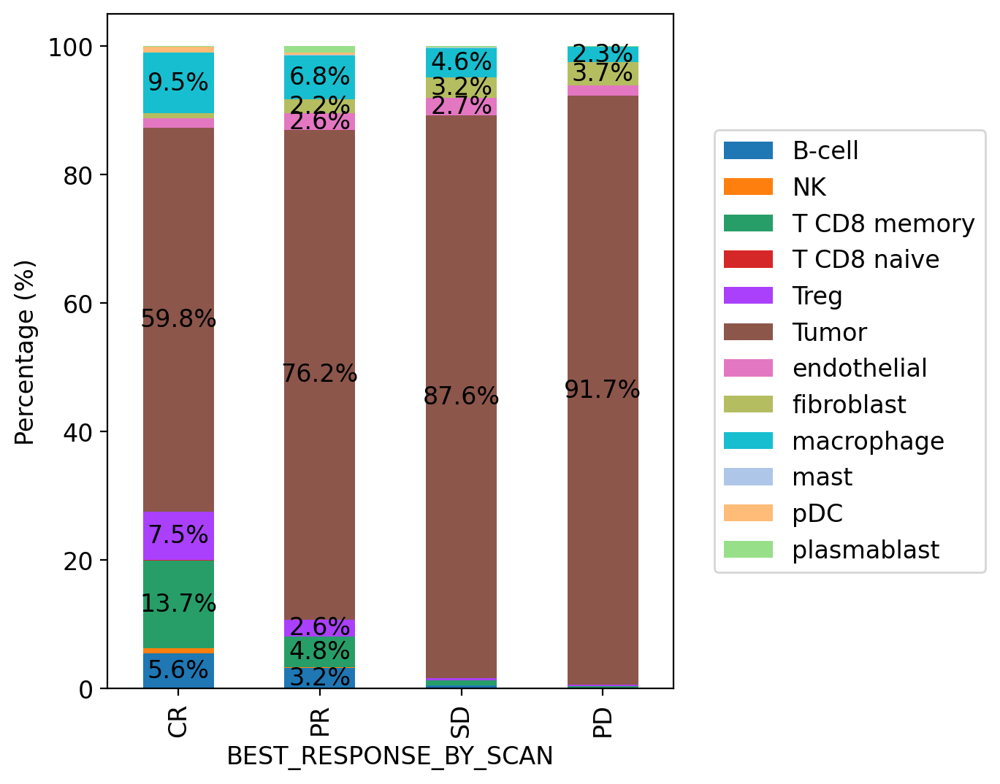

In [195]:
adata.obs['celltype_notumor'] = adata.obs['celltype'].astype(str).copy()
adata.obs['celltype_notumor'][adata.obs['celltype'].str.contains('Tumor')] = 'Tumor'
df = pd.DataFrame(adata.obs[['celltype_notumor','BEST_RESPONSE_BY_SCAN']].copy())

plt.rcParams["font.size"] = 12


count_df = df.groupby(['BEST_RESPONSE_BY_SCAN','celltype_notumor']).size().unstack(fill_value=0)

#count_df = count_df.loc[count_df.values.sum(axis=1)>10]
count_df = count_df.div(count_df.sum(axis=1),axis=0) * 100

#count_df = count_df.reindex(["No stimulation", "IFN-III","IFNa2","IL-6","TNFa","IFNg","IFNb","IFNb+IL-6","IFNb + TNFa","IFNb+ IFNg"])

ax = count_df.iloc[[0,2,3,1]].plot(kind='bar', stacked=True,figsize=(5,6),color=adata.uns['celltype_colors'])


threshold = 2.0

for bars in ax.containers:
    percentages = [(bar.get_height() ) for bar in bars]
    
    labels = [f'{percent:.1f}%' if percent > threshold else '' for percent in percentages]
    
    ax.bar_label(bars, labels=labels, label_type='center')

#plt.xlabel('Category in col1')
plt.ylabel('Percentage (%)')
#plt.title('Stacked Bar Plot by col2 Categories in Each col1 Category')

plt.legend(loc="center left", bbox_to_anchor=(1.05, 0.5))

plt.savefig('figures/cosmx_allct_composition.pdf',bbox_inches='tight')

plt.show()

In [48]:
se_list, r2_zlist, r2_slist, r2_zpvlist, r2_spvlist, S = model.get_se(edge_index,adata=adata,num_arch = 20, Kfold=1,eps=1e-10,cell_type_label='celltype',positivity_filter=False)

In [49]:
se = np.sum(se_list,axis=0)
adata_se = adata.copy()
adata_se.X = se

In [55]:
se_list_, r2_zlist_, r2_slist_, r2_zpvlist_, r2_spvlist_, S_ = model.get_se(edge_index,adata=adata_immune,num_arch = 10, Kfold=1,eps=1e-10,cell_type_label='celltype',positivity_filter=False)

/tmp/ipykernel_3902406/1308527448.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_se.var['class'][adata_se.var['r2_z']>0.4] = 'Cell-type specific'
/tmp/ipykernel_3902406/1308527448.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_se.var['class'][np.abs(adata_se.var['r2_s'].values - hr.predict(adata_se.var['r2_z'].values.reshape(-1,1)) ) / hr.scale_ > 20] = 'Spatial-induced'


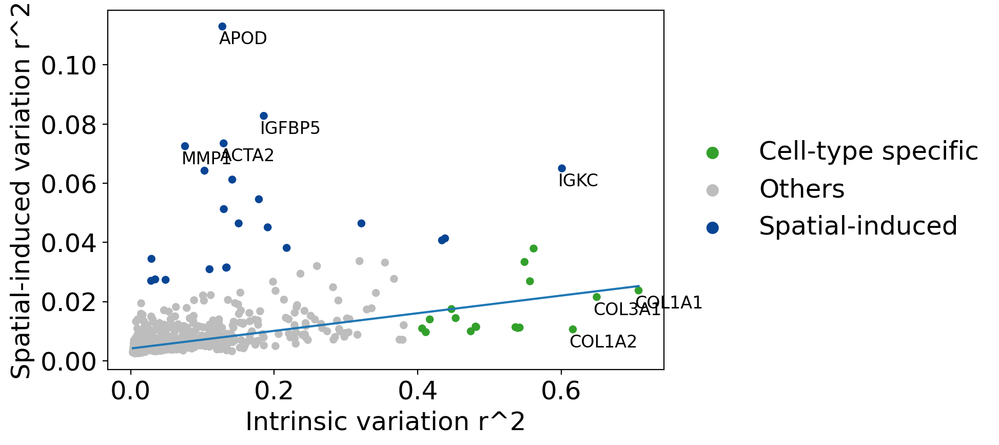

In [425]:
## Here used r2_zlist_, r2_slist_ to reveal spatial effects of nontumor cells

adata_se.var['r2_z'] = np.max(r2_zlist_,axis=0)
adata_se.var['r2_s'] = np.max(r2_slist_,axis=0)

from sklearn.linear_model import HuberRegressor

hr = HuberRegressor()
hr.fit(adata_se.var['r2_z'].values.reshape(-1,1),adata_se.var['r2_s'].values)


adata_se.var['class'] = 'Others'

adata_se.var['class'][adata_se.var['r2_z']>0.4] = 'Cell-type specific'
adata_se.var['class'][np.abs(adata_se.var['r2_s'].values - hr.predict(adata_se.var['r2_z'].values.reshape(-1,1)) ) / hr.scale_ > 20] = 'Spatial-induced'

import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
plt.rcParams["font.size"] = 18

adata_se.uns['class_colors'] = ['#33a02c','#bdbdbd','#084594']





sc.pl.scatter(adata_se.copy(),x='r2_z',y='r2_s',show=False,color='class')
plt.plot(adata_se.var['r2_z'].values[np.argsort(adata_se.var['r2_z'].values)],hr.predict(adata_se.var['r2_z'].values.reshape(-1,1))[np.argsort(adata_se.var['r2_z'].values)])

for i in range(adata_se.var['r2_s'].shape[0]):
    if adata_se.var['r2_s'][i] > 0.065 or adata_se.var['r2_z'][i] > 0.6:
        plt.text(adata_se.var['r2_z'][i]-0.005,adata_se.var['r2_s'][i]-0.006,adata_se.var_names[i],fontsize=12)
        
plt.xlabel('Intrinsic variation r^2')
plt.ylabel('Spatial-induced variation r^2')
plt.title('')

plt.savefig('figures/r2scatter_cosmx_immune.pdf',bbox_inches='tight')

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


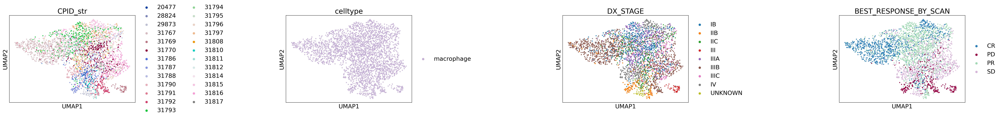

In [74]:
adata_macrose = adata_se[adata_se.obs['celltype'].str.contains('macrophage')].copy()
sc.pp.pca(adata_macrose)
sc.pp.neighbors(adata_macrose)
sc.tl.umap(adata_macrose)
sc.pl.umap(adata_macrose,color=['CPID_str','celltype','DX_STAGE','BEST_RESPONSE_BY_SCAN'],wspace=1)

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


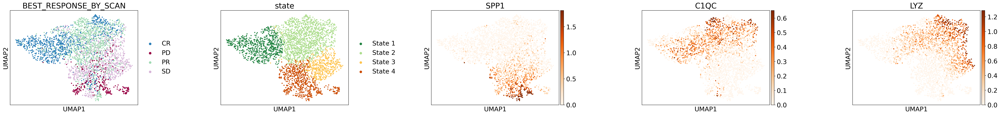

In [191]:
#sc.tl.leiden(adata_macrose,resolution=0.35)
plt.rcParams["font.size"] = 18
sc.pl.umap(adata_macrose,color=['BEST_RESPONSE_BY_SCAN','state','SPP1','C1QC','LYZ'],wspace=0.5,use_raw=False,cmap='Oranges',vmax='p99',vmin=0,ncols=5,save='macro_se_state.pdf')

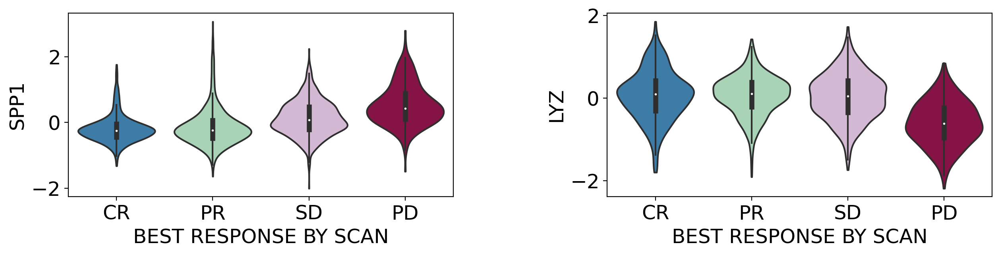

In [422]:
fig, ax = plt.subplots(1,2,figsize=(15,3))
sc.pl.violin(adata_macrose,'SPP1','BEST_RESPONSE_BY_SCAN',use_raw=False,inner='box',stripplot=False,order=['CR','PR','SD','PD'],show=False,ax=ax[0])
sc.pl.violin(adata_macrose,'LYZ','BEST_RESPONSE_BY_SCAN',use_raw=False,inner='box',stripplot=False,order=['CR','PR','SD','PD'],show=False,ax=ax[1])
plt.subplots_adjust(wspace=0.4)
plt.savefig('figures/cosmx_mp_se_plot.pdf')
#plt.tight_layout()

In [100]:
df = pd.DataFrame(adata_macrose[:,['SPP1','C1QC','LYZ']].X)
df['BEST_RESPONSE_BY_SCAN'] = adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].values.copy()
df['CPID_str'] = adata_macrose.obs['CPID_str'].values.copy()
df.to_csv('Bio_results/cosmx/mp_se.csv')

In [101]:
df = pd.DataFrame(adata_macrose.raw[:,['SPP1','C1QC','LYZ']].X)
df['BEST_RESPONSE_BY_SCAN'] = adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].values.copy()
df['CPID_str'] = adata_macrose.obs['CPID_str'].values.copy()
df.to_csv('Bio_results/cosmx/mp_nc.csv')

In [81]:
adata_tmp = adata_macrose.raw.to_adata()
sc.pp.normalize_total(adata_tmp)
sc.pp.log1p(adata_tmp)
adata_macrose.raw = adata_tmp

/usr/local/lib/python3.8/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


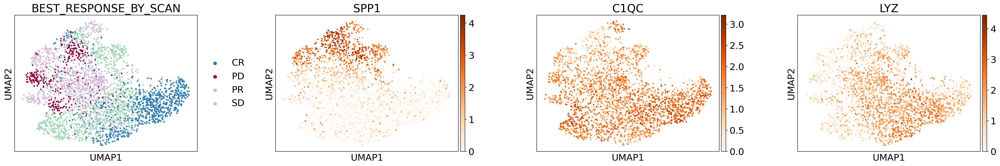

In [89]:
sc.pp.pca(adata_tmp)
sc.pp.neighbors(adata_tmp)
sc.tl.umap(adata_tmp)
sc.pl.umap(adata_tmp,color=['BEST_RESPONSE_BY_SCAN','SPP1','C1QC','LYZ'],wspace=0.3,use_raw=False,cmap='Oranges',vmin=0)

In [182]:
adata.obs['Tumor'] = 0
adata.obs['Tumor'][adata.obs['celltype'].str.contains('Tumor')] = 1

from sklearn.neighbors import kneighbors_graph
A = kneighbors_graph(adata.obsm['spatial'],n_neighbors = 10)
adata.obs['Tumor_adjacency'] = A @ adata.obs['Tumor'].values / 10

adata_macrose.obs['Tumor_adjacency'] = adata[adata_macrose.obs_names].obs['Tumor_adjacency'].values.copy()

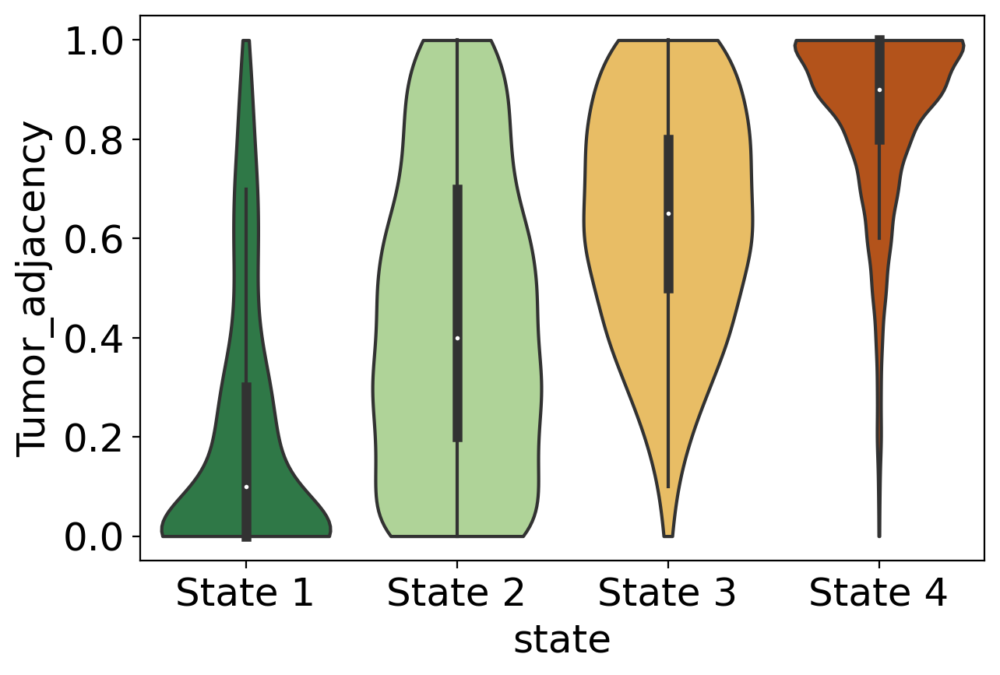

In [189]:
adata_macrose.obs['state'] = 'State 1'
adata_macrose.obs['state'][adata_macrose.obs['leiden']=='0'] = 'State 2'
adata_macrose.obs['state'][adata_macrose.obs['leiden']=='3'] = 'State 3'
adata_macrose.obs['state'][adata_macrose.obs['leiden'].isin(['2','4'])] = 'State 4'

adata_macrose.uns['state_colors'] = ['#238443','#addd8e','#fec44f','#cc4c02']
sc.pl.violin(adata_macrose,'Tumor_adjacency','state',inner='box',stripplot=False,save='state_macro_se.pdf')

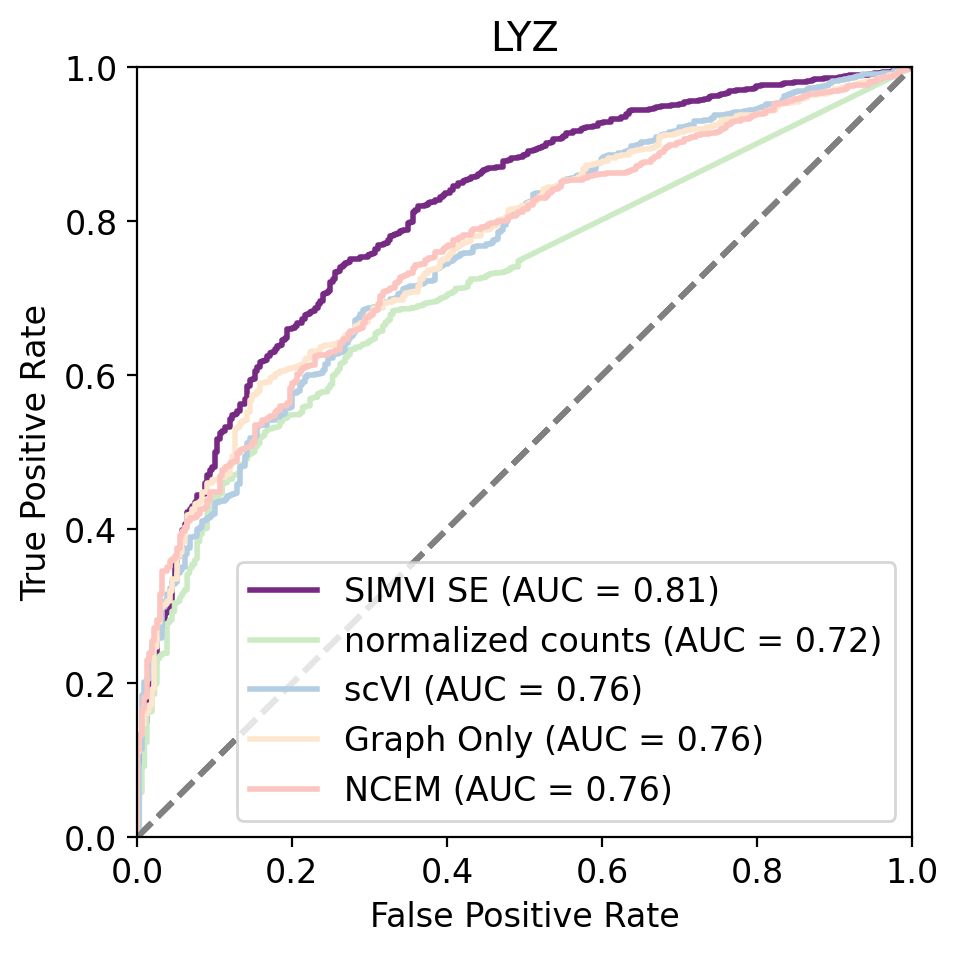

In [199]:
from sklearn.metrics import roc_curve, auc

plt.figure(figsize=(5,5))

def plot_auc_curve(y_test,y_score,name,color):
    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr,lw=2,color=color, label=name+' (AUC = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')


plot_auc_curve((~adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_macrose[:,'LYZ'].X.flatten(),'SIMVI SE','#762a83')

plot_auc_curve((~adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_macrose.raw[:,'LYZ'].X.flatten(),'normalized counts','#ccebc5')

X = np.load('Bio_results/cosmx/scvi_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((~adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'LYZ'].X.flatten(),'scVI','#b3cde3')
X = np.load('Bio_results/cosmx/graphonly_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((~adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'LYZ'].X.flatten(),'Graph Only','#fee6ce')

X = np.load('Bio_results/cosmx/ncem_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((~adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'LYZ'].X.flatten(),'NCEM','#fcc5c0')

plt.legend(loc="lower right")
plt.title('LYZ')
plt.savefig('figures/LYZ_macro_auc.pdf')
plt.show()

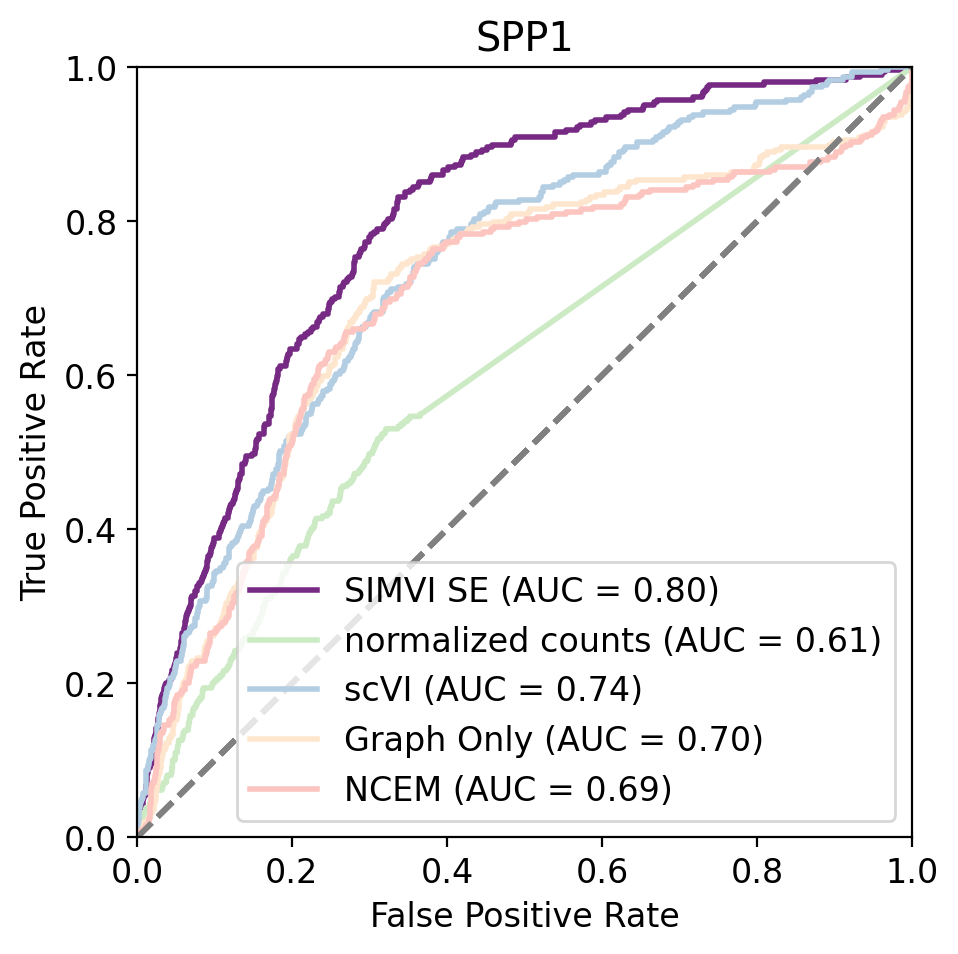

In [200]:

plt.figure(figsize=(5,5))
plot_auc_curve((adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_macrose[:,'SPP1'].X.flatten(),'SIMVI SE','#762a83')

plot_auc_curve((adata_macrose.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_macrose.raw[:,'SPP1'].X.flatten(),'normalized counts','#ccebc5')

X = np.load('Bio_results/cosmx/scvi_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'SPP1'].X.flatten(),'scVI','#b3cde3')
X = np.load('Bio_results/cosmx/graphonly_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'SPP1'].X.flatten(),'Graph Only','#fee6ce')

X = np.load('Bio_results/cosmx/ncem_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[adata_tmp.obs['celltype']=='macrophage']

plot_auc_curve((adata_tmp.obs['BEST_RESPONSE_BY_SCAN'].isin(['PD'])) * 1,adata_tmp[:,'SPP1'].X.flatten(),'NCEM','#fcc5c0')

plt.legend(loc="lower right")
plt.title('SPP1')
plt.savefig('figures/SPP1_macro_auc.pdf')
plt.show()

In [231]:
#adata_tmp = adata.copy()
sc.pp.neighbors(adata_tmp,use_rep='simvi_z')
sc.tl.leiden(adata_tmp,resolution=0.6)
df = pd.DataFrame(S.copy())
df = (df>0.5).astype(int)
df['cluster'] = adata_tmp.obs['leiden'].values.copy()
df = df.loc[df.sum(axis=1)>0]
df_ = pd.DataFrame(df.groupby('cluster').mean().max(axis=0))

/tmp/ipykernel_3902406/2546829605.py:7: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df = df.loc[df.sum(axis=1)>0]


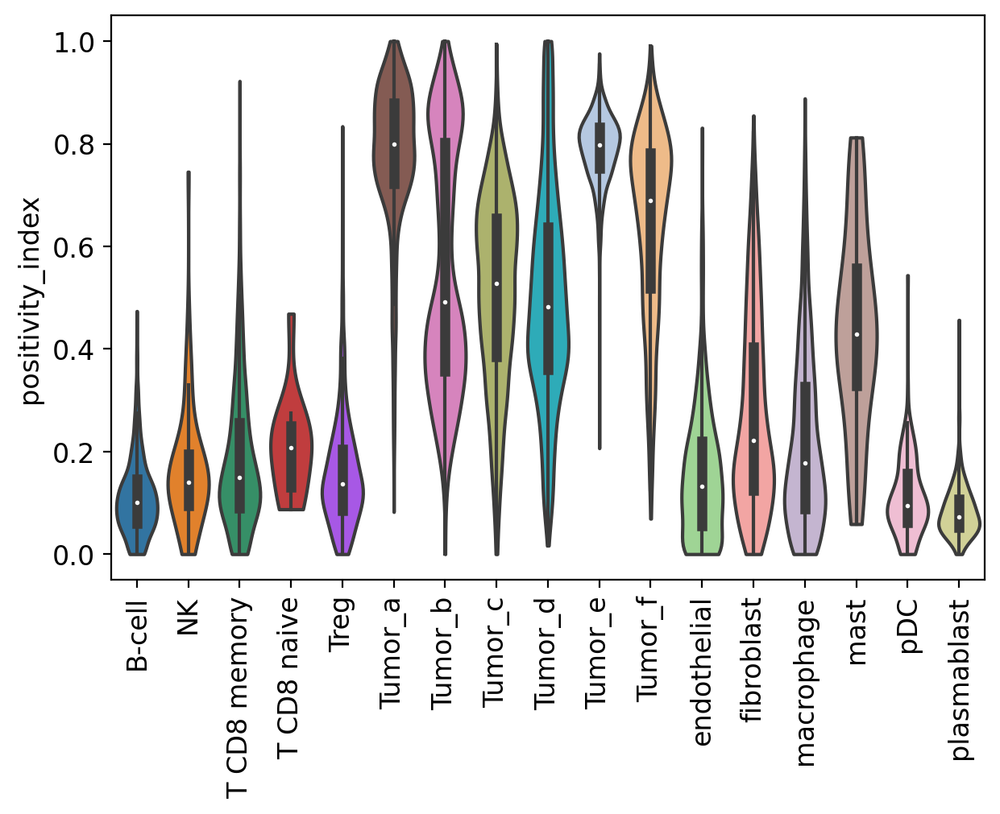

In [234]:
#adata_tmp.obs['positivity_index'] = pd.DataFrame(S.copy(),index=adata_tmp.obs_names).loc[:,df_.values>=0.9].sum(axis=1)
sc.pl.violin(adata_tmp,'positivity_index','celltype',rotation=90,stripplot=False,inner='box',save='positivity.pdf')

In [202]:
lr_df = pd.read_csv('datasets/human_lr_pair.txt',sep='\t',index_col=0)
lr_df = lr_df.loc[lr_df['ligand_gene_symbol'].isin(adata.var_names)]
lr_df = lr_df.loc[lr_df['receptor_gene_symbol'].isin(adata.var_names)]
lr_df

,ligand_gene_symbol,receptor_gene_symbol,ligand_gene_id,receptor_gene_id,ligand_ensembl_protein_id,receptor_ensembl_protein_id,ligand_ensembl_gene_id,receptor_ensembl_gene_id,evidence
lr_pair,,,,,,,,,
CX3CL1_CX3CR1,CX3CL1,CX3CR1,6376,1524,ENSP00000006053,ENSP00000351059,ENSG00000006210,ENSG00000168329,"10699158,24218476"
DCN_EGFR,DCN,EGFR,1634,1956,ENSP00000052754,ENSP00000275493,ENSG00000011465,ENSG00000146648,12105207
DCN_MET,DCN,MET,1634,4233,ENSP00000052754,ENSP00000317272,ENSG00000011465,ENSG00000105976,10942781
ICAM3_ITGAL,ICAM3,ITGAL,3385,3683,ENSP00000160262,ENSP00000349252,ENSG00000076662,ENSG00000005844,15728350
ICAM3_ITGB2,ICAM3,ITGB2,3385,3689,ENSP00000160262,ENSP00000380948,ENSG00000076662,ENSG00000160255,15728350
...,...,...,...,...,...,...,...,...,...
VIM_CD44,VIM,CD44,7431,960,ENSP00000446007,ENSP00000398632,ENSG00000026025,ENSG00000026508,22216242
FGF1_FGFR2,FGF1,FGFR2,2246,2263,ENSP00000480791,ENSP00000410294,ENSG00000113578,ENSG00000066468,16597617
FGF12_FGFR2,FGF12,FGFR2,2257,2263,ENSP00000413496,ENSP00000410294,ENSG00000114279,ENSG00000066468,16597617


In [240]:
from sklearn.neighbors import kneighbors_graph
A = kneighbors_graph(adata.obsm['spatial'],n_neighbors = 10)
adata_tmp = adata.copy()
sc.pp.normalize_total(adata_tmp)
sc.pp.log1p(adata_tmp)
M = (A.toarray() @ adata_tmp[:,lr_df['ligand_gene_symbol'].values].X)/10 + adata_tmp[:,lr_df['receptor_gene_symbol'].values].X
M = M[~adata.obs['celltype'].str.contains('Tumor')]


from scipy.stats import spearmanr
l,k = spearmanr(M,adata_immunese.X)

l[M.shape[1]:,0:M.shape[1]]

In [415]:
adata_tmp = sc.AnnData(M,obs=adata_immunese.obs.copy(),uns = adata_immunese.uns.copy())
adata_tmp.var_names = lr_df.index

/tmp/ipykernel_3902406/443938943.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_tmp = sc.AnnData(M,obs=adata_immunese.obs.copy(),uns = adata_immunese.uns.copy())


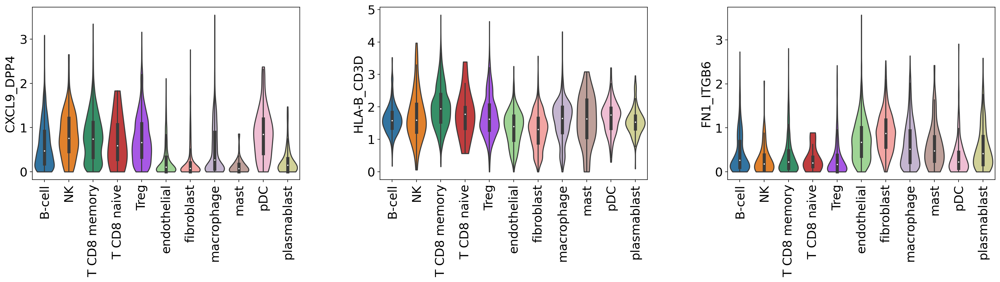

In [319]:
sc.pl.violin(adata_tmp,['CXCL9_DPP4','HLA-B_CD3D','FN1_ITGB6'],'celltype',stripplot=False,inner='box',save='cosmx_lr_ct.pdf',rotation=90)

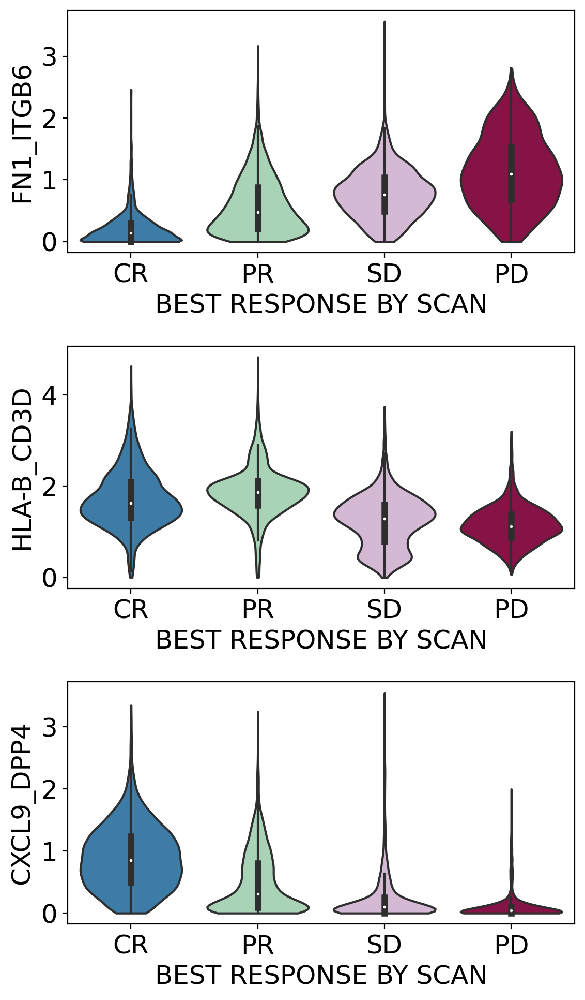

In [421]:
fig, ax = plt.subplots(3,1,figsize=(6,10))
sc.pl.violin(adata_tmp,'FN1_ITGB6','BEST_RESPONSE_BY_SCAN',use_raw=False,inner='box',stripplot=False,order=['CR','PR','SD','PD'],show=False,ax=ax[0])
sc.pl.violin(adata_tmp,'HLA-B_CD3D','BEST_RESPONSE_BY_SCAN',use_raw=False,inner='box',stripplot=False,order=['CR','PR','SD','PD'],show=False,ax=ax[1])
sc.pl.violin(adata_tmp,'CXCL9_DPP4','BEST_RESPONSE_BY_SCAN',use_raw=False,inner='box',stripplot=False,order=['CR','PR','SD','PD'],show=False,ax=ax[2])
plt.tight_layout()
plt.savefig('figures/cosmx_lr_func_plot.pdf')

In [342]:
adata_tmp.uns['log1p']['base'] = None
sc.pp.highly_variable_genes(adata_tmp,n_top_genes=200)
adata_tmp.var['means']

lr_pair
CX3CL1_CX3CR1    0.155802
DCN_EGFR         0.241993
DCN_MET          0.226970
ICAM3_ITGAL      0.382343
ICAM3_ITGB2      0.515951
                   ...   
VIM_CD44         2.013130
FGF1_FGFR2       0.174288
FGF12_FGFR2      0.079122
B2M_CD3G         2.274068
GDF10_ACVR1B     0.105485
Name: means, Length: 728, dtype: float64

In [356]:
adata_sp = sc.AnnData(l[M.shape[1]:,0:M.shape[1]])
adata_sp.obs_names = adata_immunese.var_names
adata_sp.var_names = lr_df.index

adata_sp = adata_sp[:,np.abs(adata_sp.X).max(axis=0)>0.25]
adata_sp = adata_sp[np.abs(adata_sp.X).max(axis=1)>0.25,:]
adata_sp

/tmp/ipykernel_3902406/1499675682.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_sp = sc.AnnData(l[M.shape[1]:,0:M.shape[1]])


View of AnnData object with n_obs × n_vars = 66 × 64

In [391]:
# row: 0:33, 33:48,48:
# col: 0:32, 32:48,48:

x1 = adata_sp[row_order[0:33],col_order[32:48]].X.flatten()
x2 = adata_sp[row_order[33:48],col_order[0:32]].X.flatten()

df_1 = pd.DataFrame(x1)
df_1['loc'] = 'Upper right'
df_2 = pd.DataFrame(x2)
df_2['loc'] = 'Lower left'
df_tmp = pd.concat([df_1,df_2],axis=0)

df_tmp.to_csv('Bio_results/cosmx/lr_gene_1.csv')

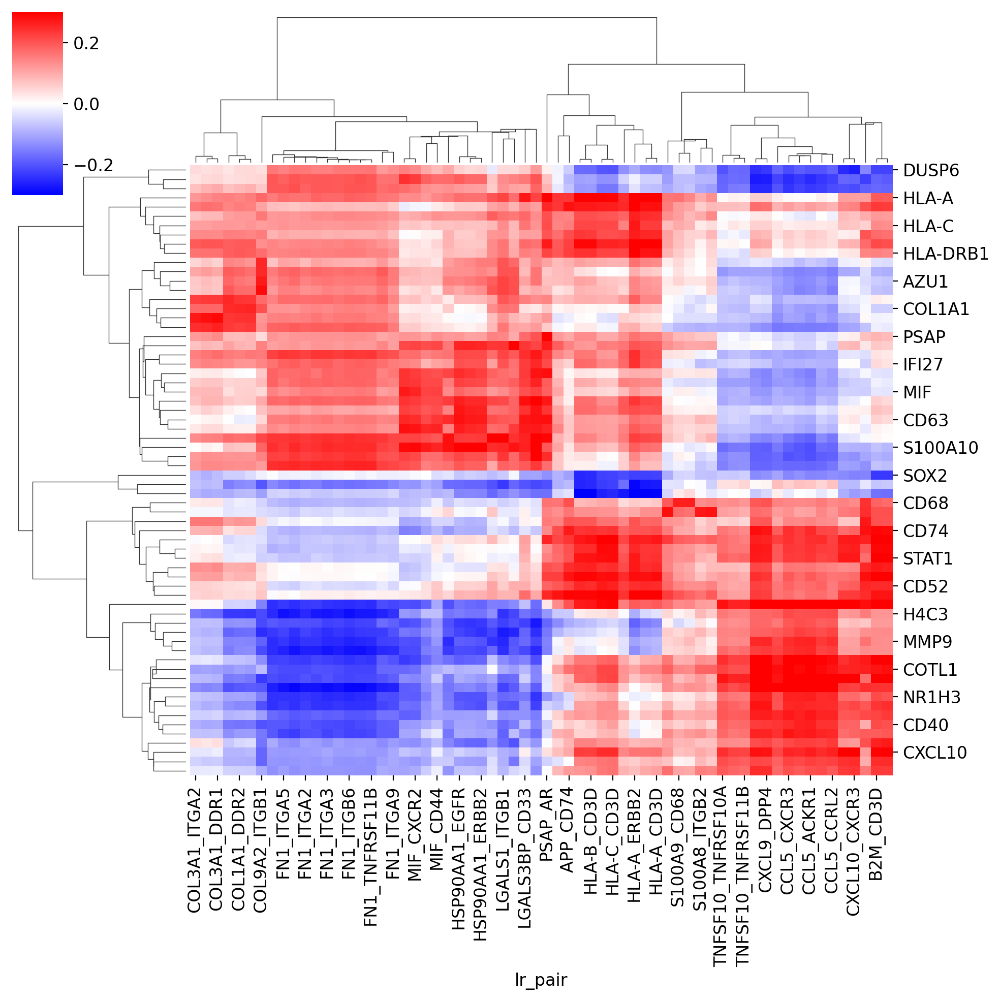

In [357]:
plt.rcParams["font.size"] = 12
g = sc.pl.clustermap(adata_sp,cmap='bwr',vmax=0.3,vmin=-0.3,method='centroid',show=False)

row_order = g.dendrogram_row.reordered_ind
col_order = g.dendrogram_col.reordered_ind

In [359]:
adata.var.to_csv('Bio_results/cosmx/fullnames.csv')

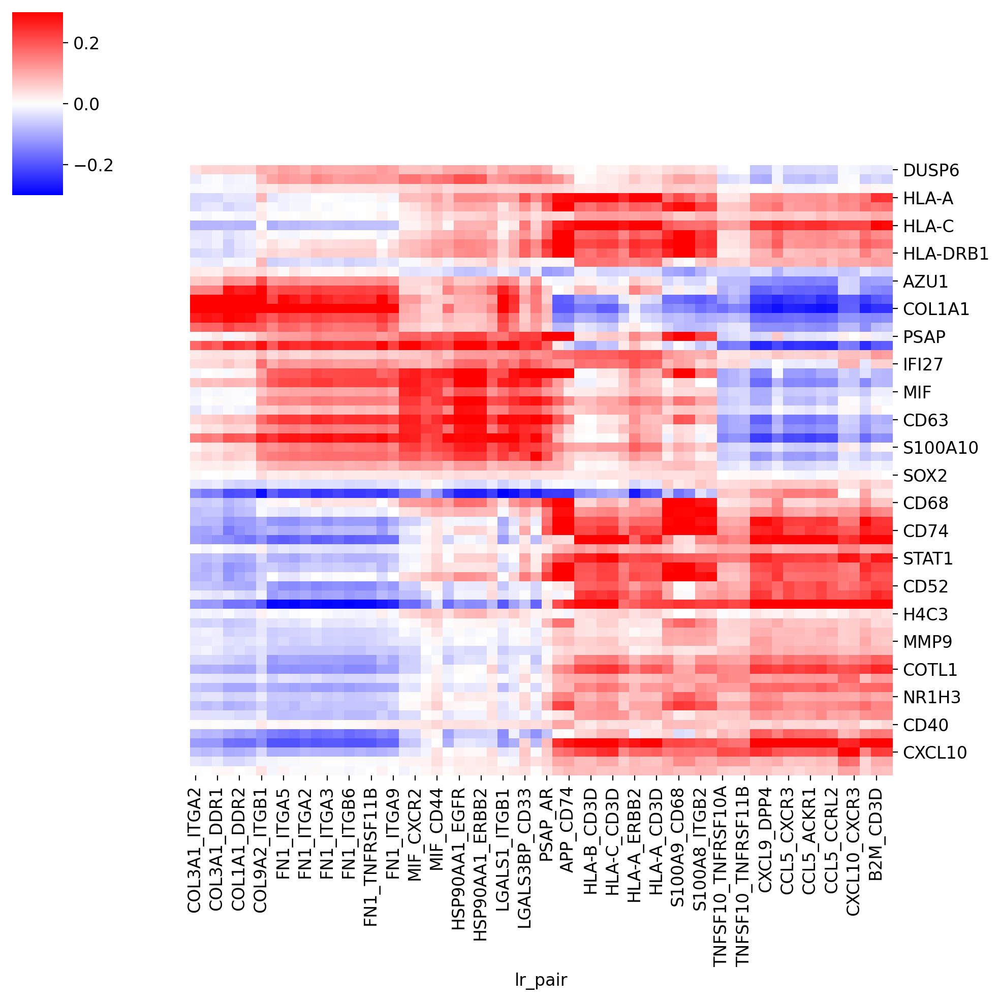

In [387]:
adata_tmp = adata_immune.copy()
sc.pp.normalize_total(adata_tmp)
sc.pp.log1p(adata_tmp)
l_,k_ = spearmanr(M,adata_tmp.X)

adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])
adata_sp_.obs_names = adata_immunese.var_names
adata_sp_.var_names = lr_df.index

#adata_sp = adata_sp[:,np.abs(adata_sp.X).max(axis=0)>0.4]
#adata_sp = adata_sp[np.abs(adata_sp.X).max(axis=1)>0.4,:]
sc.pl.clustermap(adata_sp_[adata_sp.obs_names[row_order],adata_sp.var_names[col_order]],cmap='bwr',vmax=0.3,vmin=-0.3,method='centroid',row_cluster=False,col_cluster=False,save='lrnc_subset.pdf')

/tmp/ipykernel_3902406/4222835272.py:9: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])


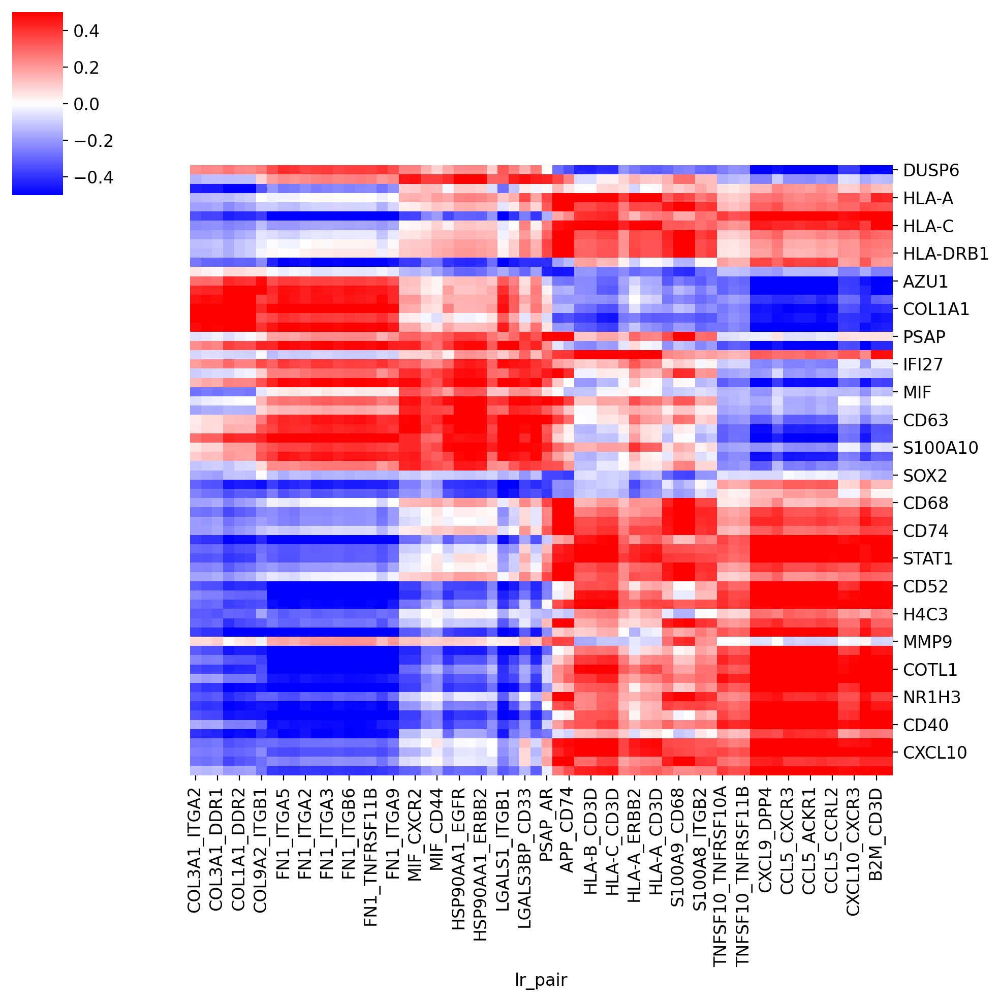

In [380]:
X = np.load('Bio_results/cosmx/ncem_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[~adata_tmp.obs['celltype'].str.contains('Tumor')]

l_,k_ = spearmanr(M,adata_tmp.X)

adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])
adata_sp_.obs_names = adata_tmp.var_names
adata_sp_.var_names = lr_df.index

#adata_sp_ = adata_sp_[:,np.abs(adata_sp_.X).max(axis=0)>0.4]
#adata_sp_ = adata_sp_[np.abs(adata_sp.X).max(axis=1)>0.4,:]
sc.pl.clustermap(adata_sp_[adata_sp.obs_names[row_order],adata_sp.var_names[col_order]],cmap='bwr',vmax=0.5,vmin=-0.5,method='centroid',row_cluster=False,col_cluster=False,save='lrncem_subset.pdf')

/tmp/ipykernel_3902406/131530702.py:9: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])


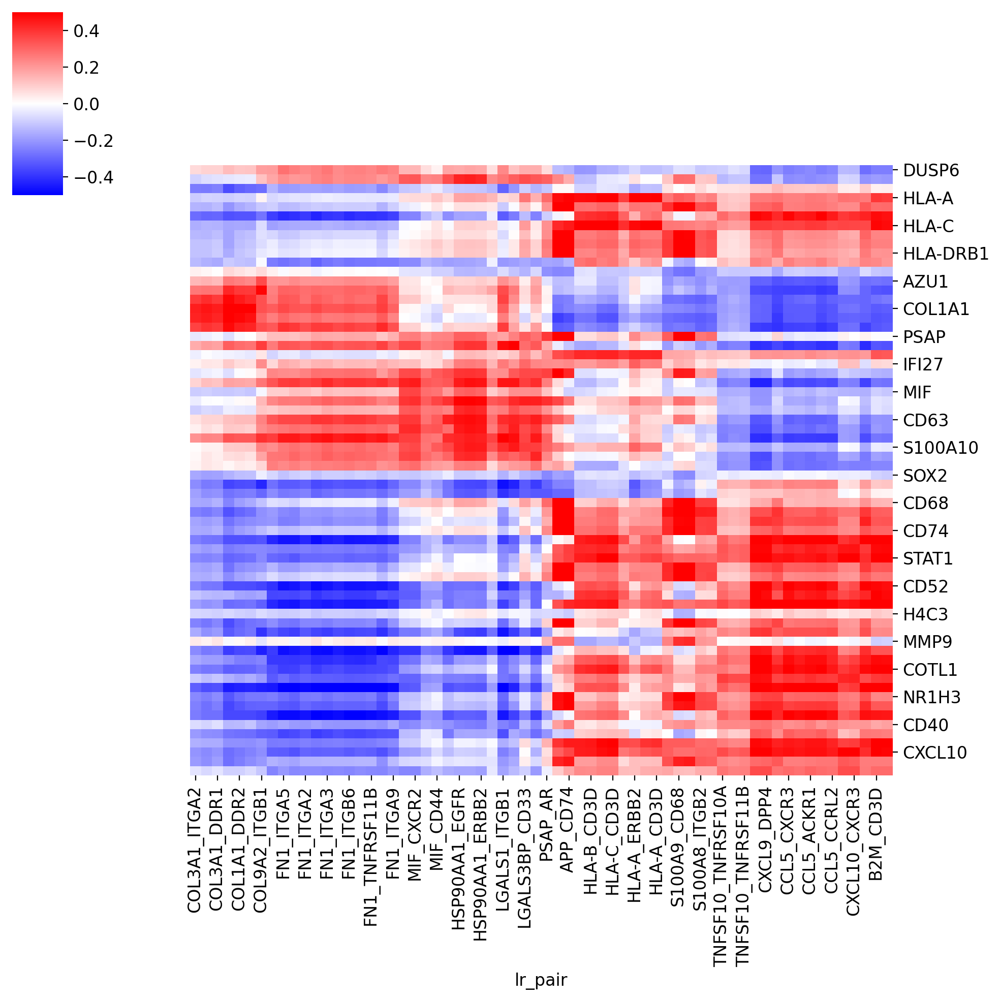

In [382]:
X = np.load('Bio_results/cosmx/scvi_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[~adata_tmp.obs['celltype'].str.contains('Tumor')]

l_,k_ = spearmanr(M,adata_tmp.X)

adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])
adata_sp_.obs_names = adata_tmp.var_names
adata_sp_.var_names = lr_df.index

#adata_sp_ = adata_sp_[:,np.abs(adata_sp_.X).max(axis=0)>0.4]
#adata_sp_ = adata_sp_[np.abs(adata_sp.X).max(axis=1)>0.4,:]
sc.pl.clustermap(adata_sp_[adata_sp.obs_names[row_order],adata_sp.var_names[col_order]],cmap='bwr',vmax=0.5,vmin=-0.5,method='centroid',row_cluster=False,col_cluster=False,save='lrscvi_subset.pdf')

/tmp/ipykernel_3902406/627002712.py:9: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])


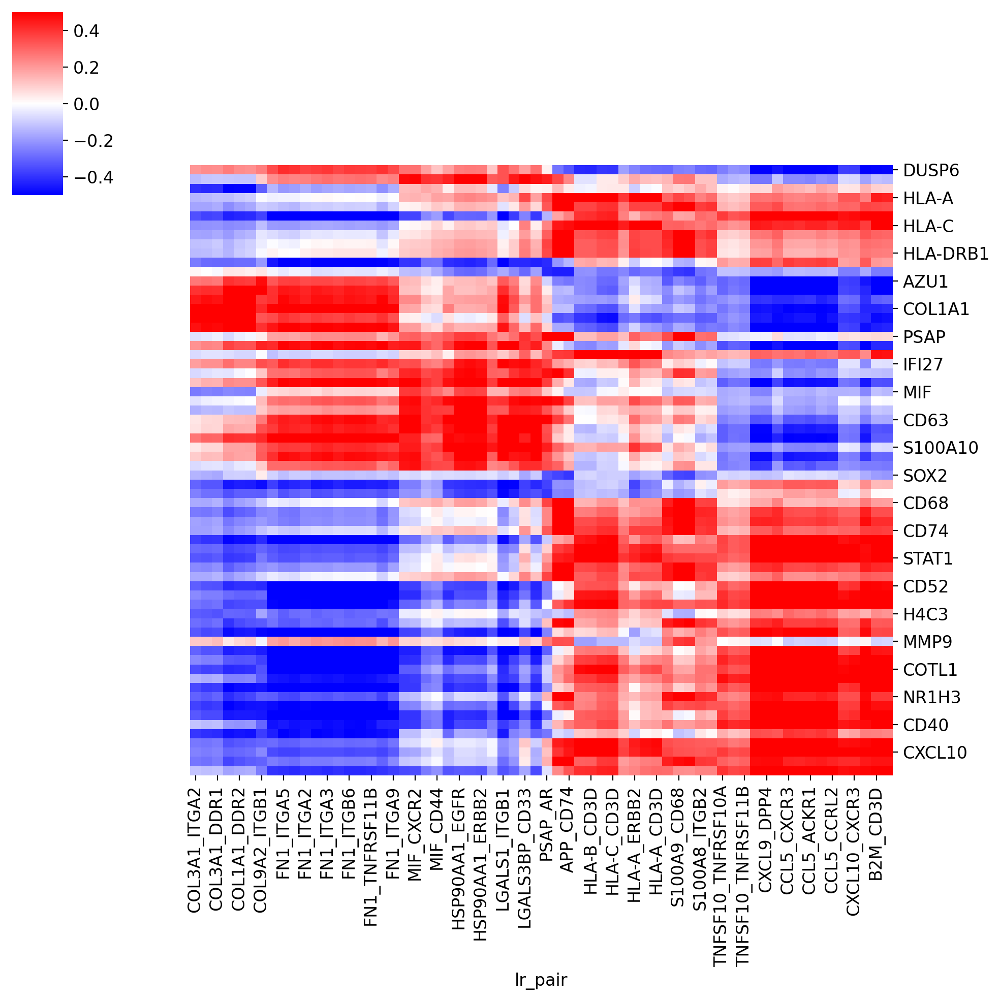

In [383]:
X = np.load('Bio_results/cosmx/graphonly_nc.npy')
adata_tmp = adata.copy()
adata_tmp.X = X

adata_tmp = adata_tmp[~adata_tmp.obs['celltype'].str.contains('Tumor')]

l_,k_ = spearmanr(M,adata_tmp.X)

adata_sp_ = sc.AnnData(l_[M.shape[1]:,0:M.shape[1]])
adata_sp_.obs_names = adata_tmp.var_names
adata_sp_.var_names = lr_df.index

#adata_sp_ = adata_sp_[:,np.abs(adata_sp_.X).max(axis=0)>0.4]
#adata_sp_ = adata_sp_[np.abs(adata_sp.X).max(axis=1)>0.4,:]
sc.pl.clustermap(adata_sp_[adata_sp.obs_names[row_order],adata_sp.var_names[col_order]],cmap='bwr',vmax=0.5,vmin=-0.5,method='centroid',row_cluster=False,col_cluster=False,save='lrgo_subset.pdf')

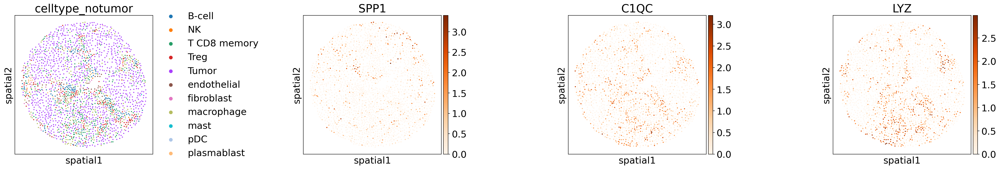

In [433]:
adata_31788 = adata[adata.obs['CPID_str']=='31788'].copy()
sc.pp.normalize_total(adata_31788)
sc.pp.log1p(adata_31788)
sc.pl.spatial(adata_31788,color=['celltype_notumor','SPP1','C1QC','LYZ'],size=30,wspace=0.3,cmap='Oranges',spot_size=1,use_raw=False)

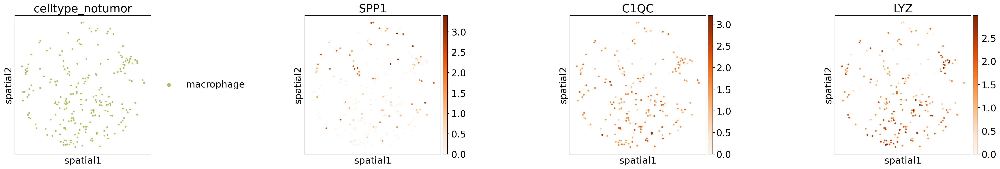

In [444]:
sc.pl.spatial(adata_31788[adata_31788.obs['celltype']=='macrophage'],color=['celltype_notumor','SPP1','C1QC','LYZ'],size=30,wspace=0.3,cmap='Oranges',spot_size=1.5,use_raw=False)

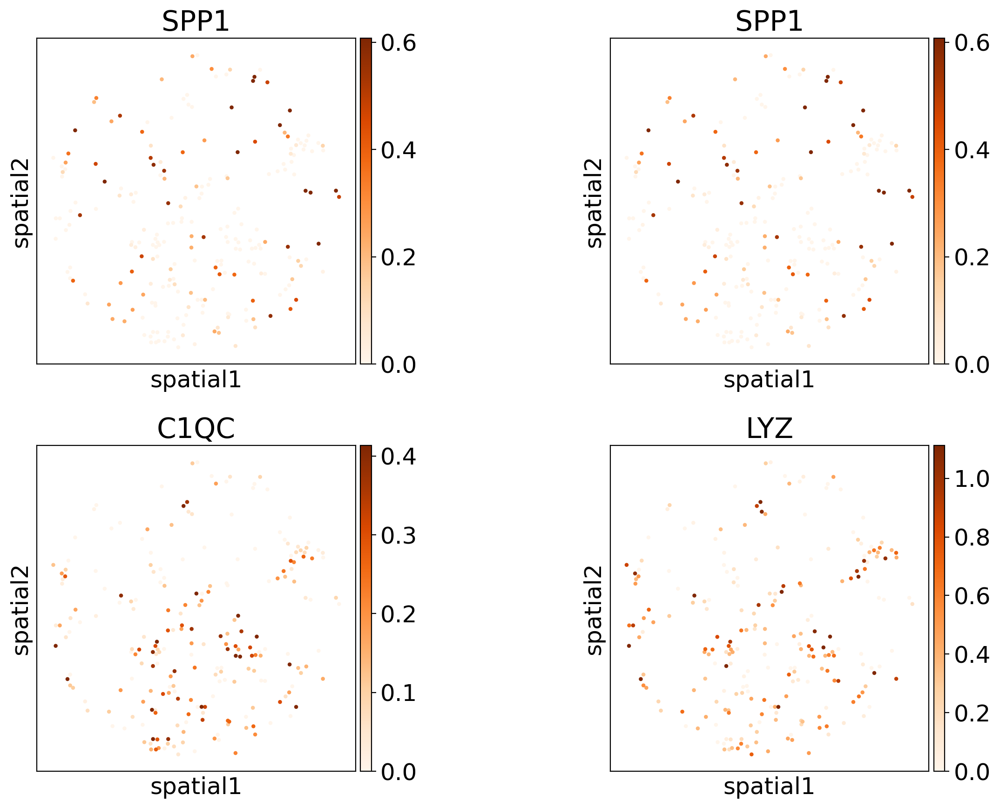

In [442]:
sc.pl.spatial(adata_immunese[(adata_immunese.obs['celltype']=='macrophage') & (adata_immunese.obs['CPID_str']=='31788')],color=['SPP1','SPP1','C1QC','LYZ'],size=30,cmap='Oranges',spot_size=1.5,use_raw=False,vmax='p95',vmin=0,ncols=2)